Training Perceptron: 100%|████████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 58922.00it/s]
Animation size has reached 20995233 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


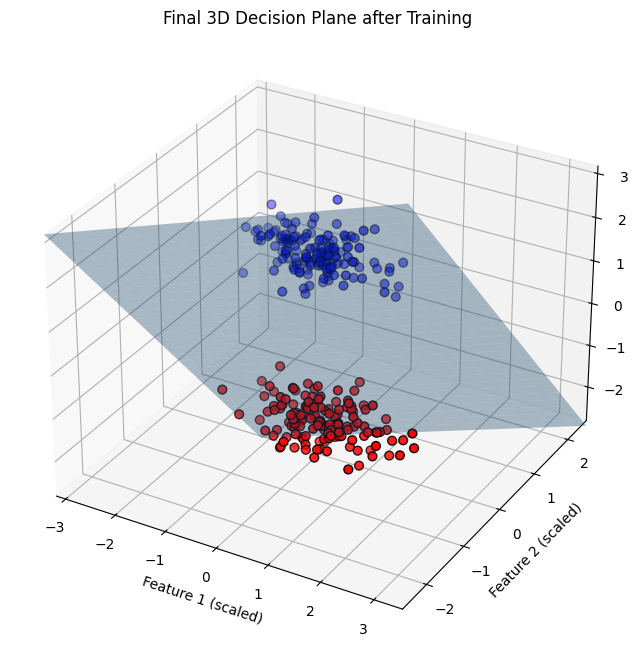

Training completed.
Final bias: 0.0
Final weights: (0.021891261617282186, -0.09086323351882132, -0.05299580943246085)


In [2]:
# perceptron_3d_animation_updated.py
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler
from matplotlib.animation import FuncAnimation
from tqdm import tqdm
from IPython.display import HTML, display

# -------------------
# Settings / reproducibility (tweak as needed)
# -------------------
np.random.seed(42)

# animation / training hyperparams
n_epochs = 500         # total perceptron updates (frames approx = n_epochs/record_every + 1)
lr = 0.05
record_every = 1       # record weights every N epochs; set to 1 to record every step
interval_ms = 100      # ms between frames (tweak for speed)

# -------------------
# Perceptron (stochastic) with per-step recording
# -------------------
def step(x):
    return 1 if x >= 0 else 0

def Perceptron_Animate(X, y, epochs, lr=0.1, record_every=1):
    """
    Stochastic perceptron: choose one random sample per epoch.
    Returns:
      - weight_history: list of recorded augmented weight vectors [bias, w1, w2, w3]
                        (includes initial weights as weight_history[0])
      - sample_history: list of sample indices used for each epoch (length = epochs)
                        sample_history[i] is index used to produce weight_history[i+1]
    """
    X = np.asarray(X)
    y = np.asarray(y).ravel()
    X_aug = np.insert(X, 0, 1.0, axis=1)  # bias column
    weights = np.zeros(X_aug.shape[1], dtype=float)  # start from zeros: [b, w1, w2, w3]
    weight_history = [weights.copy()]
    sample_history = []

    for epoch in tqdm(range(epochs), desc="Training Perceptron"):
        j = np.random.randint(0, X_aug.shape[0])
        y_pred = step(np.dot(X_aug[j], weights))
        weights = weights + lr * (y[j] - y_pred) * X_aug[j]
        sample_history.append(int(j))

        # record periodically
        if (epoch + 1) % record_every == 0:
            weight_history.append(weights.copy())

    # ensure final weights recorded (should be if record_every divides or record_every==1)
    if not np.allclose(weight_history[-1], weights):
        weight_history.append(weights.copy())

    return weight_history, sample_history, X_aug

# -------------------
# Create 3D dataset
# -------------------
X, y = make_blobs(n_samples=300, centers=2, n_features=3, cluster_std=2.0, random_state=42)
scaler = StandardScaler()
X = scaler.fit_transform(X)

# -------------------
# Train perceptron and record
# -------------------
weight_history, sample_history, X_aug_full = Perceptron_Animate(X, y, n_epochs, lr=lr, record_every=record_every)

if len(weight_history) == 0:
    raise RuntimeError("No weight history recorded. Increase epochs or decrease record_every.")

# -------------------
# Prepare 3D plotting grid & axis limits
# -------------------
x_min, x_max = X[:,0].min() - 1.0, X[:,0].max() + 1.0
y_min, y_max = X[:,1].min() - 1.0, X[:,1].max() + 1.0
z_min, z_max = X[:,2].min() - 1.0, X[:,2].max() + 1.0

# grids used when computing plane (may be interpreted differently depending on plane orientation)
xx_grid, yy_grid = np.meshgrid(np.linspace(x_min, x_max, 30),
                               np.linspace(y_min, y_max, 30))
yy_grid_v, zz_grid_v = np.meshgrid(np.linspace(y_min, y_max, 30),
                                   np.linspace(z_min, z_max, 30))
zz_grid_h, yy_grid_h = np.meshgrid(np.linspace(z_min, z_max, 30),
                                   np.linspace(y_min, y_max, 30))

EPS = 1e-8

# -------------------
# Helper: compute surface points for a given augmented weight vector w = [b, w1, w2, w3]
# Handles three parameterizations and returns (Xsurf, Ysurf, Zsurf) or (None,None,None)
# -------------------
def compute_plane_surface(w):
    b, w1, w2, w3 = float(w[0]), float(w[1]), float(w[2]), float(w[3])

    # Case A: solve for z (most common)
    if abs(w3) > EPS:
        Z = (-b - w1 * xx_grid - w2 * yy_grid) / w3
        return xx_grid, yy_grid, Z

    # Case B: w3 ~ 0, but w1 != 0 -> solve for x: x = (-b - w2*y - w3*z)/w1
    if abs(w1) > EPS:
        Xsurf = (-b - w2 * yy_grid_v - w3 * zz_grid_v) / w1
        Ysurf = yy_grid_v
        Zsurf = zz_grid_v
        return Xsurf, Ysurf, Zsurf

    # Case C: w3 ~ 0 and w1 ~ 0, but w2 != 0 -> solve for y
    if abs(w2) > EPS:
        Xsurf = xx_grid
        Zsurf = zz_grid_h
        Ysurf = (-b - w1 * Xsurf - w3 * Zsurf) / w2
        return Xsurf, Ysurf, Zsurf

    # Degenerate: all near zero -> no meaningful plane
    return None, None, None

# -------------------
# Setup 3D animation figure
# -------------------
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# base scatter
scatter = ax.scatter(X[:,0], X[:,1], X[:,2], c=y, cmap='bwr', edgecolor='k', s=40, zorder=1)

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_zlim(z_min, z_max)
ax.set_xlabel("Feature 1 (scaled)")
ax.set_ylabel("Feature 2 (scaled)")
ax.set_zlabel("Feature 3 (scaled)")
title = ax.set_title("3D Perceptron Decision Plane Animation")

# keep reference to surface so we can remove it each frame
current_surface = [None]

# marker for the sample used in the last update (large outlined point)
sample_marker = ax.scatter([], [], [], s=200, facecolors='none', edgecolors='k', linewidth=1.5, zorder=3)

def clear_previous_surface():
    """Safely remove previous surface(s) while leaving the scatter points intact."""
    # Remove specifically the stored surface if possible
    if current_surface[0] is not None:
        try:
            current_surface[0].remove()
        except Exception:
            pass
        current_surface[0] = None
    # Also remove any Poly3DCollection-like objects that are not the base scatter:
    # (this is conservative; we avoid deleting the main scatter by checking sizes)
    try:
        # `ax.collections` contains scatter and surface collections; leave scatter alone by checking sizes
        new_collections = []
        for col in ax.collections:
            try:
                # small heuristic: the scatter we added has offsets length == number of points (300),
                # surfaces often have no offsets or fewer. If unsure, we keep collections with many offsets.
                off = getattr(col, "_offsets3d", None)
                if off is None:
                    # likely a surface/other - remove it by skipping adding to new list
                    continue
                else:
                    new_collections.append(col)
            except Exception:
                # if any error, keep the collection
                new_collections.append(col)
        ax.collections[:] = new_collections
    except Exception:
        # harmless if this fails in some Matplotlib versions
        pass

def compute_accuracy(w):
    """Compute accuracy (%) of weights w on the full dataset X_aug_full"""
    scores = X_aug_full.dot(w)
    preds = (scores >= 0).astype(int)
    acc = float((preds == y).mean() * 100.0)
    return acc

def update(frame):
    # remove previous plane safely
    clear_previous_surface()

    # compute which recorded epoch this frame corresponds to (weight_history[0] = initial)
    w = weight_history[frame]
    Xs, Ys, Zs = compute_plane_surface(w)

    if Xs is None:
        # no meaningful plane: nothing to draw this frame
        title.set_text(f"Recorded step {frame} (no meaningful plane)")
        # clear sample marker as well
        sample_marker._offsets3d = ([], [], [])
        return (title,)

    # Clip Zs for plotting stability
    Zs = np.clip(Zs, z_min - 10.0, z_max + 10.0)

    # plot the surface and save the reference
    try:
        surf = ax.plot_surface(Xs, Ys, Zs, alpha=0.35, rstride=1, cstride=1, linewidth=0, antialiased=True)
        current_surface[0] = surf
    except Exception as e:
        # skip plotting this frame if it fails
        print(f"plot_surface failed for frame {frame}: {e}")
        current_surface[0] = None
        title.set_text(f"Recorded step {frame} (surface plotting failed)")
        return (title,)

    # Determine and highlight the sample used to produce this recorded weight:
    # weight_history[0] = initial (no sample used), for frame>=1 sample used = sample_history[ recorded_epoch_index ]
    if frame == 0:
        # initial - no sample highlighted
        sample_marker._offsets3d = ([], [], [])
    else:
        # we need to find which epoch index produced weight_history[frame]
        # Because we recorded every 'record_every' epochs, the mapping is:
        # recorded_index -> epoch_index = frame * record_every (approx), but we stored sample_history per epoch.
        # To be precise: we recorded weights whenever (epoch+1) % record_every == 0 and appended weights.
        # Reconstruct the epoch index that produced weight_history[frame]:
        # If record_every == 1 then weight_history[frame] was created by epoch = frame-1.
        # General approach: assume sequential recording at fixed intervals: epoch_idx = frame * record_every - 1
        epoch_idx = frame * record_every - 1
        # clamp
        epoch_idx = max(0, min(len(sample_history) - 1, epoch_idx))
        sample_idx = sample_history[epoch_idx]
        sx, sy, sz = X[sample_idx, 0], X[sample_idx, 1], X[sample_idx, 2]
        # update sample_marker
        try:
            sample_marker._offsets3d = ([sx], [sy], [sz])
        except Exception:
            # older matplotlib versions: remove & re-create marker
            try:
                sample_marker.remove()
            except Exception:
                pass
            # re-create
            ax.scatter([sx], [sy], [sz], s=200, facecolors='none', edgecolors='k', linewidth=1.5, zorder=3)

    # title with approximate epoch and accuracy
    approx_epoch = frame * record_every
    acc = compute_accuracy(w)
    title.set_text(f"Recorded step {frame}  ≈ epoch {approx_epoch}   Accuracy: {acc:.1f}%")
    return (current_surface[0], sample_marker, title)

# -------------------
# Create animation
# -------------------
# Use blit=False for best compatibility with to_jshtml
ani = FuncAnimation(fig, update, frames=len(weight_history), interval=interval_ms, blit=False, repeat=False)

# -------------------
# Try to embed JS animation in Jupyter; do NOT save any files
# -------------------
display_js = False
try:
    js_html = ani.to_jshtml()
    display(HTML(js_html))
    display_js = True
except Exception as e:
    # IMPORTANT: no saving, no files — only inform and continue to static plot
    print("JS animation embedding failed in this environment (some JupyterLab configs).")
    print("No files will be saved. Showing final static 3D plot instead.")
    # fall through to static figure below

plt.close(fig)  # avoid duplicate output in some environments

# -------------------
# Static final decision plane (always show)
# -------------------
final_w = weight_history[-1]
b_final, w1_final, w2_final, w3_final = final_w.tolist()

Xs_f, Ys_f, Zs_f = compute_plane_surface(final_w)

fig2 = plt.figure(figsize=(10, 8))
ax2 = fig2.add_subplot(111, projection='3d')
ax2.scatter(X[:,0], X[:,1], X[:,2], c=y, cmap='bwr', edgecolor='k', s=40)

if Xs_f is not None:
    # clip Z for stability
    Zs_f = np.clip(Zs_f, z_min - 10.0, z_max + 10.0)
    ax2.plot_surface(Xs_f, Ys_f, Zs_f, alpha=0.35, rstride=1, cstride=1, linewidth=0, antialiased=True)
else:
    print("Final plane degenerate (weights near zero) — no plane plotted.")

ax2.set_xlim(x_min, x_max)
ax2.set_ylim(y_min, y_max)
ax2.set_zlim(z_min, z_max)
ax2.set_xlabel("Feature 1 (scaled)")
ax2.set_ylabel("Feature 2 (scaled)")
ax2.set_zlabel("Feature 3 (scaled)")
ax2.set_title("Final 3D Decision Plane after Training")
plt.show()

print("Training completed.")
print("Final bias:", b_final)
print("Final weights:", (w1_final, w2_final, w3_final))
